Required libraries for the project.

In [3]:
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
from scipy.spatial import distance
from scipy.ndimage.filters import convolve
from scipy.sparse import diags, csr_matrix
from scipy.sparse.linalg import spsolve
import argparse
from argparse import RawTextHelpFormatter
import glob
from os import makedirs
from os.path import join, exists, basename, splitext
import cv2
import matplotlib.pyplot as plt
import pprint
import os
import ntpath
import matplotlib.pyplot as plt
from PIL import Image

from google.colab import files
uploaded = files.upload()

<ipython-input-3-0f84834b02c5>:5: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  from scipy.ndimage.filters import convolve


Saving normal1.jpeg to normal1 (3).jpeg
Saving normal2.jpeg to normal2 (3).jpeg
Saving overexp1.jpeg to overexp1 (3).jpeg
Saving overexp2.jpeg to overexp2 (3).jpeg
Saving overexp3.jpeg to overexp3 (3).jpeg
Saving ovr1.jpg to ovr1 (3).jpg
Saving ovr2.jpg to ovr2 (3).jpg
Saving sample_overexposed.jpg to sample_overexposed (3).jpg
Saving sample_Underexposure.jpg to sample_Underexposure (3).jpg
Saving und1.jpg to und1 (3).jpg
Saving und2.jpg to und2 (3).jpg
Saving underexp1.jpeg to underexp1 (3).jpeg
Saving underexp2.jpeg to underexp2 (3).jpeg
Saving underexp3.jpeg to underexp3 (3).jpeg
Saving underexp4.jpg to underexp4 (3).jpg
Saving underexp5.jpeg to underexp5 (3).jpeg


In [4]:
#default values
image_config={"be":1.0,"bs":1.0,"bc":1.0}       #1,1,1
image_config["size"]=15
image_config["sigma"]=5    #3
image_config["gamma"]=0.45   #0.6
image_config["lamda"]=0.15 #0.15
image_config["eps"]=1e-5
image_config["neighbour_dist"]=1  #1
pprint.pprint(image_config)

{'bc': 1.0,
 'be': 1.0,
 'bs': 1.0,
 'eps': 1e-05,
 'gamma': 0.45,
 'lamda': 0.15,
 'neighbour_dist': 1,
 'sigma': 5,
 'size': 15}


In [5]:
def init_kernel_pixel(i, j,image_config):
    size = image_config["size"]
    spatial_sigma = image_config["sigma"]
    dist = distance.euclidean((i, j), (size // 2, size // 2)) ** 2
    ker_val = np.exp(-0.5 * dist / (spatial_sigma ** 2))
    return ker_val

def init_kernel(image_config):
    kernel = np.zeros((image_config["size"],image_config["size"]))
    kernel2 = np.zeros((image_config["size"],image_config["size"]))
    for i in range(image_config["size"]):
        for j in range(image_config["size"]):
            kernel[i, j] = init_kernel_pixel(i,j , image_config)

    return kernel

#print(init_kernel(image_config).shape)
image_config["kernel"] = init_kernel(image_config)

- Get four neighbors of each pixel and assign label based on axis. Helps deciding which smoothness weight to apply (wx or wy)

In [6]:
def get_neighbors(p, n, m):
    i, j = p // m, p % m
    nb_dist = image_config["neighbour_dist"]
    d = {}
    if i + nb_dist < n:
        d[(i + nb_dist) * m + j] = (i + nb_dist, j, 0)
    if i - nb_dist >= 0:
        d[(i - nb_dist) * m + j] = (i - nb_dist, j, 0)

    if j + nb_dist < m:
        d[i * m + j + nb_dist] = (i, j + nb_dist, 1)
    if j - nb_dist >= 0:
        d[i * m + j - nb_dist] = (i, j - nb_dist, 1)

    return d

In [7]:
def forward_illumination(im,image_config):
    L = np.max(im, axis=2)                 #max of each channel
    L_refined = improved_L_map(L, image_config)
    L_refined_3d = np.stack((L_refined,)*3, axis=-1)
    im_corrected = np.true_divide(im ,L_refined_3d)
    return im_corrected

#image = cv2.imread("low_light1.jpg")
#cv2_imshow(forward_illumination(image,image_config))



*   **under_corrected** stores the image where underexposed regions are enhanced **(i.e Forward Illumination)**.
*   **over_corrected** stores the image where overexposed regions are enhanced **(i.e Reverse Illumination)**.



In [8]:
def illuminate_image(image,image_config):
    kernel=init_kernel(image_config)
    image_config["kernel"]=kernel

    im_normalized = image.astype(float) / 255.
    inv_im_normalized = 1 - im_normalized

    under_corrected = forward_illumination(im_normalized, image_config)
    over_corrected_inv =  forward_illumination(inv_im_normalized, image_config)
    over_corrected = 1 - over_corrected_inv

    return under_corrected, over_corrected


Finally, **lamda** is responsible for the balance between the two terms; increasing the value of *lamda* results in progressively smoother images.


In [9]:
def improved_L_map(L, image_config):
    kernel = image_config["kernel"]

    Lp_h = cv2.Sobel(L, cv2.CV_64F, 1, 0, ksize=1)
    Lp_v = cv2.Sobel(L, cv2.CV_64F, 0, 1, ksize=1)

    T_h = convolve(np.ones(L.shape), kernel, mode='constant')
    T_h = T_h / (np.abs(convolve(Lp_h, kernel, mode='constant')) + image_config["eps"])

    T_v = convolve(np.ones(L.shape), kernel, mode='constant')
    T_v = T_v / (np.abs(convolve(Lp_v, kernel, mode='constant')) + image_config["eps"])

    wx=T_h / (np.abs(Lp_h) + image_config["eps"])
    wy=T_v / (np.abs(Lp_v) + image_config["eps"])


    L_1d = L.copy().flatten()
    row = []
    column = []
    data = []
    n, m = L.shape

    for p in range(0,n * m):
        diag = 0
        d = get_neighbors(p, n, m)
        for q in d:
            k, l, x = d[q]

            weight = wx[k, l] if x else wy[k, l]
            row.append(p)
            column.append(q)
            data.append(-weight)
            diag += weight
        row.append(p)
        column.append(p)
        data.append(diag)

    F = csr_matrix((data, (row, column)), shape=(n * m, n * m))

    Id = diags([np.ones(n * m)], [0])
    A = Id + image_config["lamda"] * F
    L_refined = spsolve(csr_matrix(A), L_1d, permc_spec=None, use_umfpack=True).reshape((n, m))

    L_refined = np.clip(L_refined, image_config["eps"], 1) ** image_config["gamma"]

    return L_refined

#image = cv2.imread("low_light1.jpg")
#L = np.max(image, axis=2)
#improved_L_map(L, image_config).shape

In [10]:
#assuming img2 and img3 are normalized by 255
#return value is multiplied by 255 beforehand
def merge(img1, img2, img3):
  merge_mertens = cv2.createMergeMertens(image_config["bc"], image_config["bs"], image_config["be"])
  img2=img2*255
  img3=img3*255
  images = [np.clip(x , 0, 255).astype("uint8") for x in [img1, img2, img3]]
  fused_images = merge_mertens.process(images)
  return fused_images*255



Observations we made after experimenting with varying values of **Exposure, Contrast and Saturation.**

**Exposure**

Exposure value is = 
Normal Image      0       0.5       1       

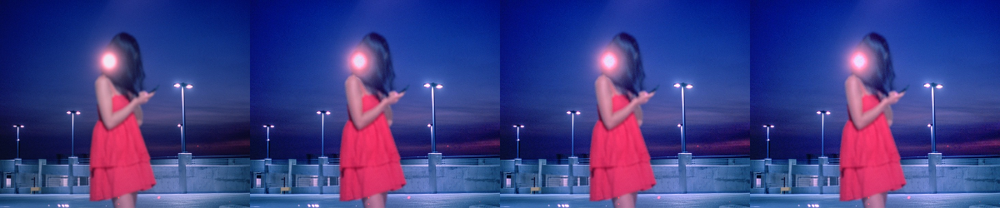

Exposure value is = 
Normal Image      0       0.5       1       

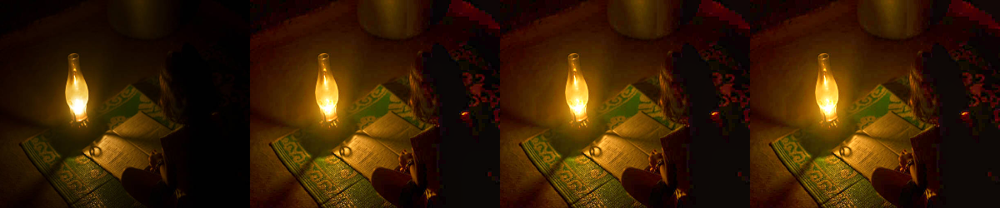

Exposure value is = 
Normal Image      0       0.5       1       

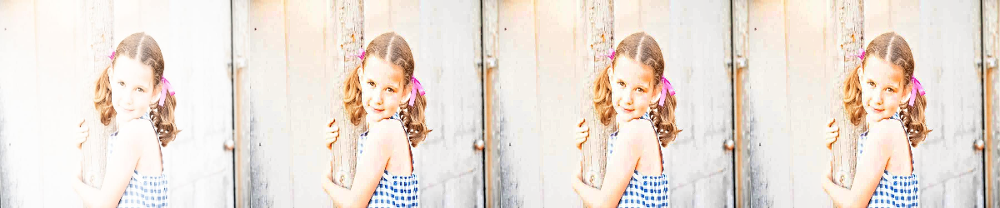

Exposure value is = 
Normal Image      0       0.5       1       

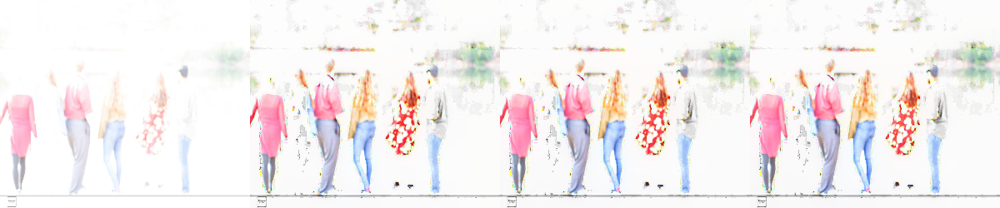

In [11]:
from PIL import Image
imgpath=[]
exposure_val=[0,0.5,1]
imgs=["underexp1.jpeg","underexp2.jpeg","overexp1.jpeg","overexp2.jpeg"]
for path in imgs:
  image = cv2.resize(cv2.imread(path),(300,250))
  corr1 , corr2 = illuminate_image(image,image_config)
  print("Exposure value is = ")
  print("Normal Image ",end="     ")
  for i in range(0,len(exposure_val)):
    print(exposure_val[i],end="       ")
    image_config["be"]=exposure_val[i]
    fused_images = merge(image, corr1, corr2)
    if i==0:
        image2 = np.hstack((image,fused_images))
    else:
        image2 = np.hstack((image2,fused_images))

  cv2_imshow(image2)


**Contrast**

Contrast value is = 
Normal Image      0       0.5       1       

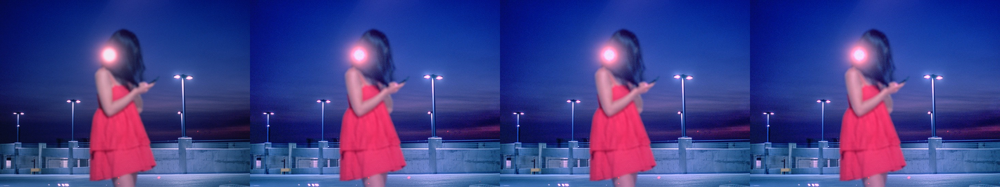

Contrast value is = 
Normal Image      0       0.5       1       

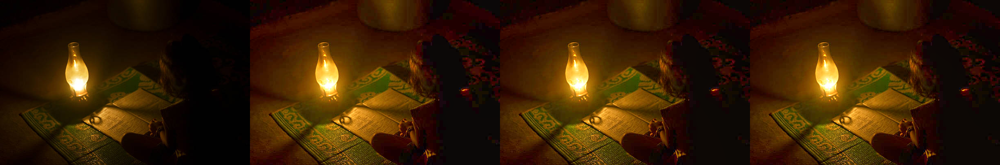

Contrast value is = 
Normal Image      0       0.5       1       

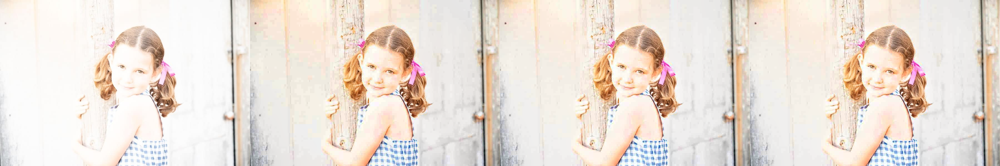

Contrast value is = 
Normal Image      0       0.5       1       

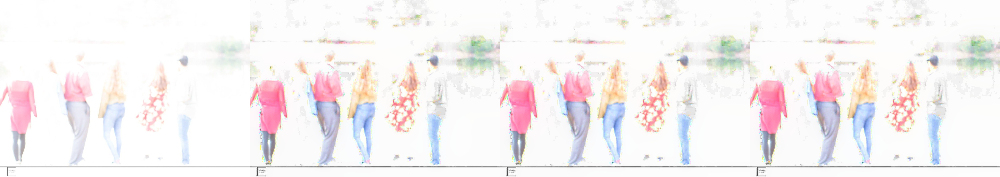

In [12]:
contrast_val=[0,0.5,1]
imgs=["underexp1.jpeg","underexp2.jpeg","overexp1.jpeg","overexp2.jpeg"]
for path in imgs:
  image = cv2.imread(path)
  corr1 , corr2 = illuminate_image(image,image_config)
  print("Contrast value is = ")
  print("Normal Image ",end="     ")
  for i in range(0,len(contrast_val)):
    print(contrast_val[i],end="       ")
    image_config["bc"]=contrast_val[i]
    fused_images = merge(image, corr1, corr2)
    if i==0:
        image2 = np.hstack((image,fused_images))
    else:
        image2 = np.hstack((image2,fused_images))

  cv2_imshow(image2)


**Saturation**

Saturation value is = 
Normal Image      0       0.5       1       

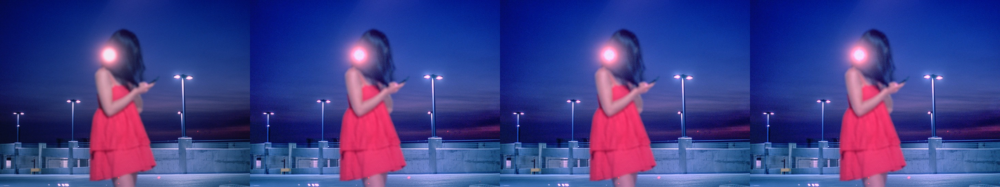

Saturation value is = 
Normal Image      0       0.5       1       

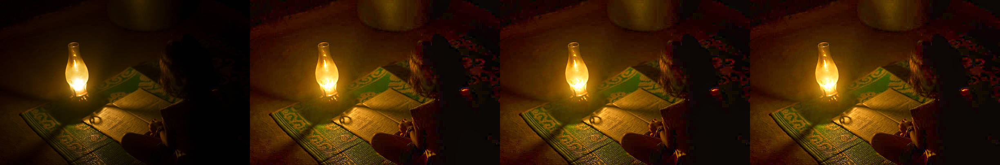

Saturation value is = 
Normal Image      0       0.5       1       

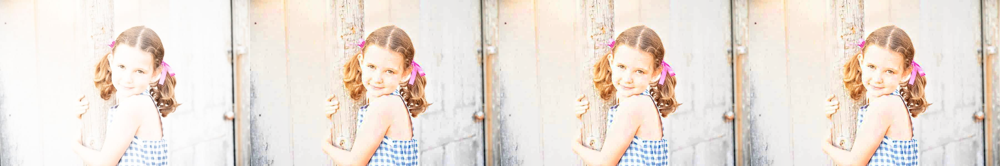

Saturation value is = 
Normal Image      0       0.5       1       

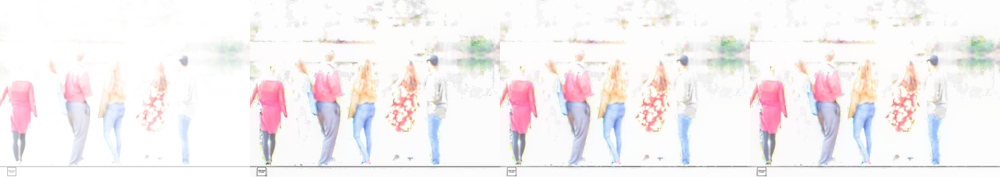

In [13]:
imgpath=[]
sat_val=[0,0.5,1]
imgs=["underexp1.jpeg","underexp2.jpeg","overexp1.jpeg","overexp2.jpeg"]
for path in imgs:
  image = cv2.imread(path)
  corr1 , corr2 = illuminate_image(image,image_config)
  print("Saturation value is = ")
  print("Normal Image ",end="     ")
  for i in range(0,len(sat_val)):
    print(sat_val[i],end="       ")
    image_config["bs"]=sat_val[i]
    fused_images = merge(image, corr1, corr2)
    if i==0:
        image2 = np.hstack((image,fused_images))
    else:
        image2 = np.hstack((image2,fused_images))

  cv2_imshow(image2)


In [14]:
def correct_and_store_image(imgpath , output_dir = "outputs"):
    image = cv2.imread(imgpath)

    # create new directory for saving result
    if not exists(output_dir):
        makedirs(output_dir)

    enhanced_image1, enhanced_image2 = illuminate_image(image,image_config)
    fused_image = merge(image, enhanced_image1, enhanced_image2)

    name = ntpath.basename(imgpath)     #Extract file name from path, no matter what the os/path format
    name,ext = name.split(".")
    op_name = name + "_corrected." + ext

    cv2.imwrite(join(output_dir , op_name), fused_image)

    #return all 4 images as list
    return [image , enhanced_image1, enhanced_image2 , fused_image]

In [15]:
im_list = correct_and_store_image("underexp2.jpeg" , output_dir="mydir" )

From left:- 1)original image 2) underexpose corrected image 3) overexpose corrected image 4) fused image



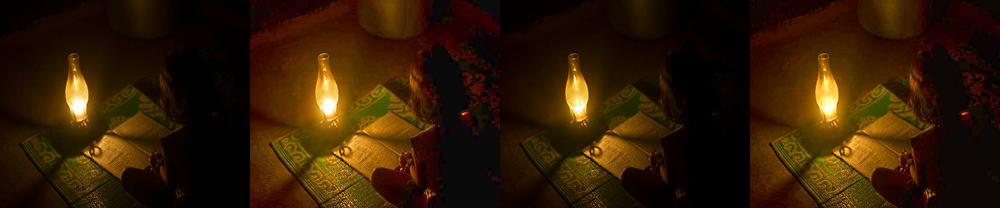

In [16]:
im_list = [cv2.resize(img , (300,250)) for img in im_list]
all_img = np.concatenate((im_list[0] , im_list[1]*255 , im_list[2]*255 , im_list[3]), axis=1)
print("From left:- 1)original image 2) underexpose corrected image 3) overexpose corrected image 4) fused image\n")
cv2_imshow(all_img)

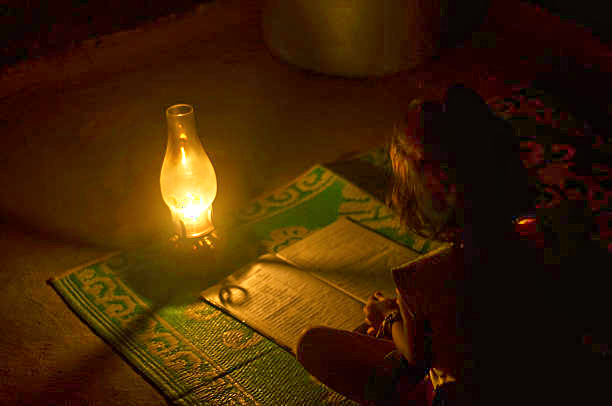

In [17]:
imgpath = "underexp2.jpeg"
image = cv2.imread(imgpath)
corr1 , corr2 = illuminate_image(image,image_config)
fused_images = merge(image, corr1, corr2)
cv2_imshow(fused_images)

## Results

### **1) For UnderExposed Images**


Original images



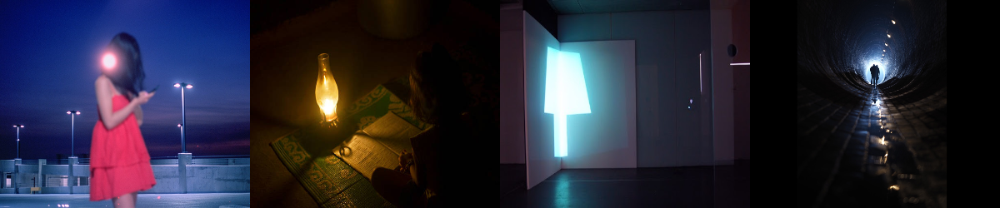


Corrected images



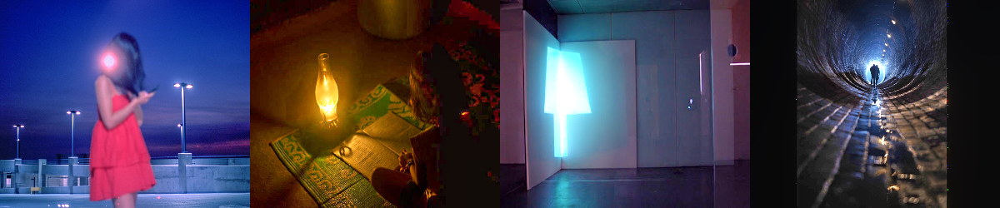

In [18]:
imgpaths = ["underexp1.jpeg","underexp2.jpeg","underexp3.jpeg","underexp4.jpg"]
image_config["gamma"]=0.5
for i in range(0,len(imgpaths)):
    imgpath = imgpaths[i]
    image = cv2.resize(cv2.imread(imgpath),(300,250))
    corr1 , corr2 = illuminate_image(image,image_config)
    fused_images = merge(image, corr1, corr2)

    if i==0:
        original = image
        corrected = fused_images
    else:
        original = np.hstack((original,image))
        corrected = np.hstack((corrected,fused_images))

print("\nOriginal images\n")
cv2_imshow(original)
print("\nCorrected images\n")
cv2_imshow(corrected)

### **2) For OverExposed Images**


Original images



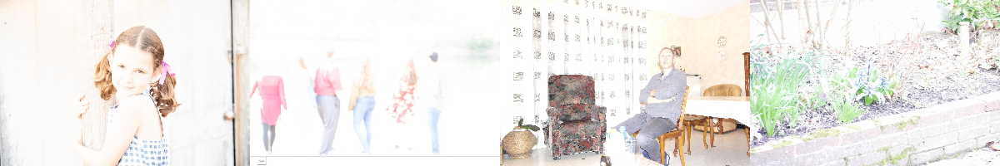


Corrected images



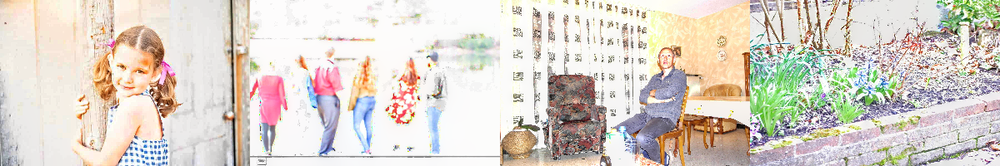

In [19]:
imgpaths = ["overexp1.jpeg" , "overexp2.jpeg" , "overexp3.jpeg" , "ovr2.jpg"]
for i in range(0,len(imgpaths)):
    imgpath = imgpaths[i]
    image = cv2.resize(cv2.imread(imgpath),(300,200))
    corr1 , corr2 = illuminate_image(image,image_config)
    fused_images = merge(image, corr1, corr2)

    if i==0:
        original = image
        corrected = fused_images
    else:
        original = np.hstack((original,image))
        corrected = np.hstack((corrected,fused_images))

print("\nOriginal images\n")
cv2_imshow(original)
print("\nCorrected images\n")
cv2_imshow(corrected)

## **Changing values of Gamma**

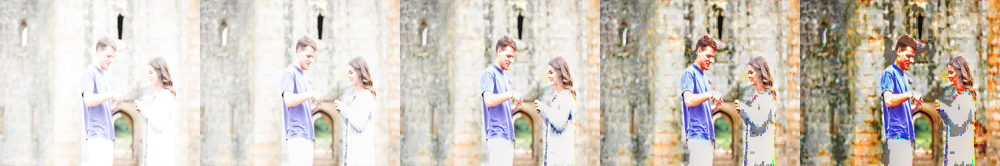

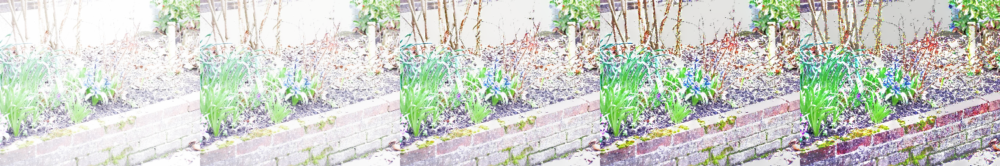

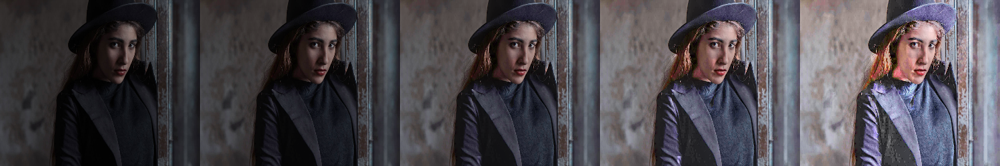

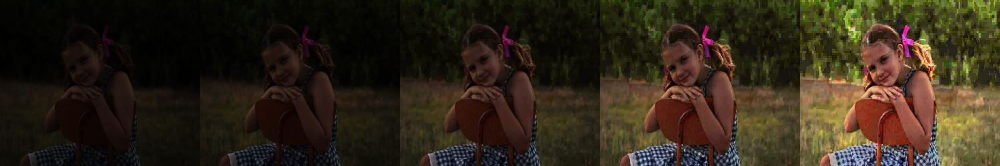

In [20]:
from PIL import Image
import numpy
from PIL import Image
import numpy
gm_val=[0.2,0.4,0.6,0.8]
imgs=["ovr1.jpg","ovr2.jpg","und1.jpg","und2.jpg"]
for j in range(0,len(imgs)):
    for i in range(0,len(gm_val)):
        imgpath = imgs[j]
        image_config["gamma"]=gm_val[i]
        image = cv2.resize(cv2.imread(imgpath),(300,250))
        corr1 , corr2 = illuminate_image(image,image_config)
        fused_images = merge(image,corr1, corr2)
        if i==0:
            image2 = numpy.hstack((image,fused_images))
        else:
            image2 = numpy.hstack((image2,fused_images))
    cv2_imshow(image2)




### **First image is the original image which is taken as input. Other images are the output on various values of gamma like 0.2, 0.4, 0.6, 0.8**

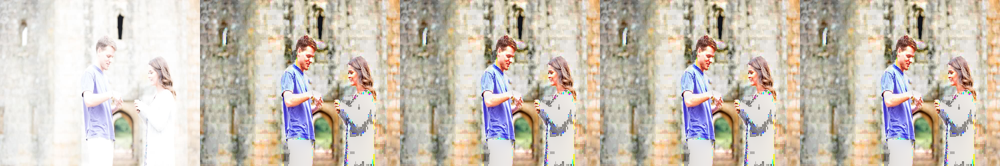

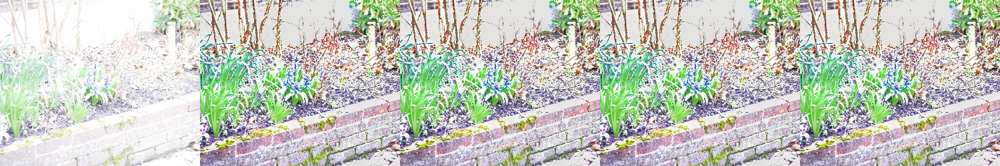

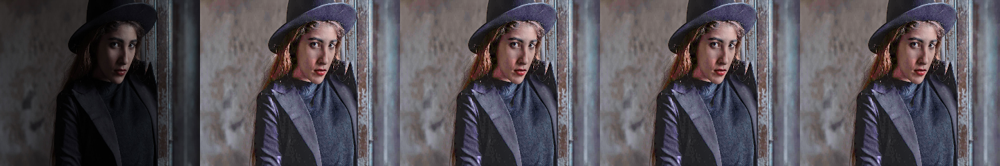

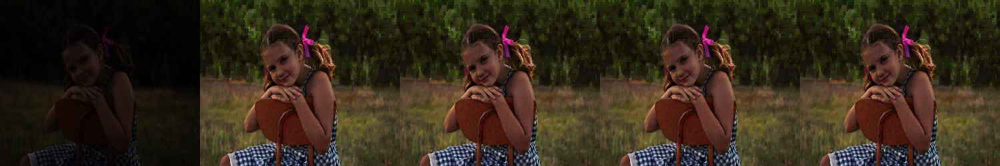

In [21]:
image_config["gamma"]=0.6
gm_val=[0.01,0.1,0.45,0.8]
imgs=["ovr1.jpg","ovr2.jpg","und1.jpg","und2.jpg"]
for j in range(0,len(imgs)):
    for i in range(0,len(gm_val)):
        imgpath = imgs[j]
        image_config["lambda"]=gm_val[i]
        image = cv2.resize(cv2.imread(imgpath),(300,250))
        corr1 , corr2 = illuminate_image(image,image_config)
        fused_images = merge(image,corr1 , corr2)
        if i==0:
            image2 = numpy.hstack((image,fused_images))
        else:
            image2 = numpy.hstack((image2,fused_images))

    cv2_imshow(image2)


Qualitative Analysis using Chart Visualization

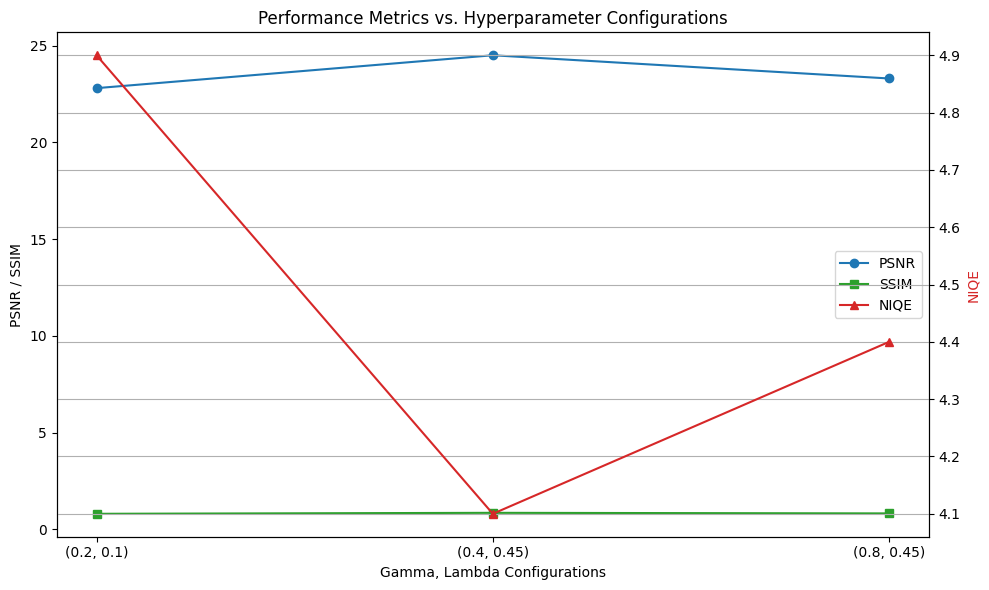

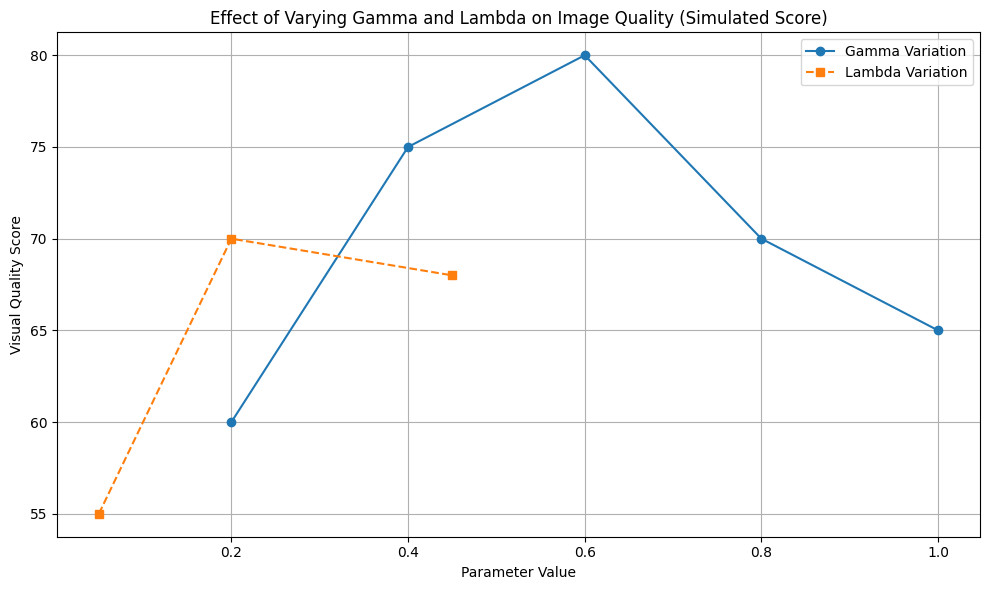

In [22]:
configs = ['(0.2, 0.1)', '(0.4, 0.45)', '(0.8, 0.45)']
psnr = [22.8, 24.5, 23.3]
ssim = [0.80, 0.85, 0.82]
niqe = [4.9, 4.1, 4.4]

fig, ax1 = plt.subplots(figsize=(10, 6))

ax2 = ax1.twinx()
ax1.plot(configs, psnr, marker='o', color='tab:blue', label='PSNR')
ax1.plot(configs, ssim, marker='s', color='tab:green', label='SSIM')
ax2.plot(configs, niqe, marker='^', color='tab:red', label='NIQE')

ax1.set_xlabel('Gamma, Lambda Configurations')
ax1.set_ylabel('PSNR / SSIM', color='black')
ax2.set_ylabel('NIQE', color='tab:red')
plt.title('Performance Metrics vs. Hyperparameter Configurations')

lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, loc='best')

plt.grid(True)
plt.tight_layout()
plt.savefig('chart_hyperparam.png')
plt.show()


# Simulated visual quality scores
gamma_values = [0.2, 0.4, 0.6, 0.8, 1.0]
gamma_scores = [60, 75, 80, 70, 65]

lambda_values = [0.05, 0.2, 0.45]
lambda_scores = [55, 70, 68]

plt.figure(figsize=(10, 6))
plt.plot(gamma_values, gamma_scores, marker='o', label='Gamma Variation')
plt.plot(lambda_values, lambda_scores, marker='s', linestyle='--', label='Lambda Variation')

plt.xlabel('Parameter Value')
plt.ylabel('Visual Quality Score')
plt.title('Effect of Varying Gamma and Lambda on Image Quality (Simulated Score)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig('effect_gamma_lambda.png')
plt.show()

### **First image is the original image which is taken as input. Other images are the output on various values of lambda like 0.01, 0.1, 0.45, 0.8**

# Contrast enhancement using histogram Equalization

- Apply the equalization method for one channel image. Here we call this method iteratively for each channel.

In [23]:
#for 1 channel
def equalize_histogram(image):
    image_hist = np.zeros(256)
    image_flat = image.flatten()

    for pix in image:
        image_hist[pix] += 1

    cum_sum = np.cumsum(image_hist)
    cum_min = cum_sum.min()
    cum_max = cum_sum.max()

    uniform_norm = ((cum_sum - cum_min) * 255) / (cum_max - cum_min)

    uniform_norm = uniform_norm.astype('int')

    image_eq = uniform_norm[image_flat]
    image_eq = np.reshape(image_eq, image.shape)

    return image_eq

- Split image to 3 channels, apply contrast enhancement and then merge all channels.

In [24]:
def contrast_enhance(image_src, gray_scale=False):
    if not gray_scale:
        ch_list = []
        for i in range(3):
            ch_image = image_src[:, :, i]
            ch_image_eq = equalize_histogram(ch_image)
            ch_list.append(ch_image_eq)

        image_eq = np.dstack(ch_list)

    return np.uint8(image_eq)

- Images turn out to be sharper with enhancement.

Left:- Original 	 Right:- Enhanced



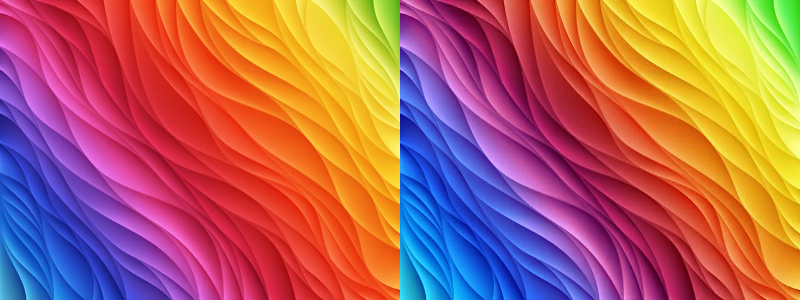

In [25]:
imgpath = "normal2.jpeg"
image = cv2.resize(cv2.imread(imgpath),(400,300))
enh_img = contrast_enhance(image)

comp = np.concatenate((image , enh_img), axis=1)
print("Left:- Original \t Right:- Enhanced\n")
cv2_imshow(comp)

#### Visualization of Histogram equalization in each channel

<ipython-input-26-9b4e264e0b58>:6: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(image[:,:,i].flatten(),256,[0,256], color = color_list[i])
<ipython-input-26-9b4e264e0b58>:8: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(enh_img[:,:,i].flatten(),256,[0,256], color = color_list[i])


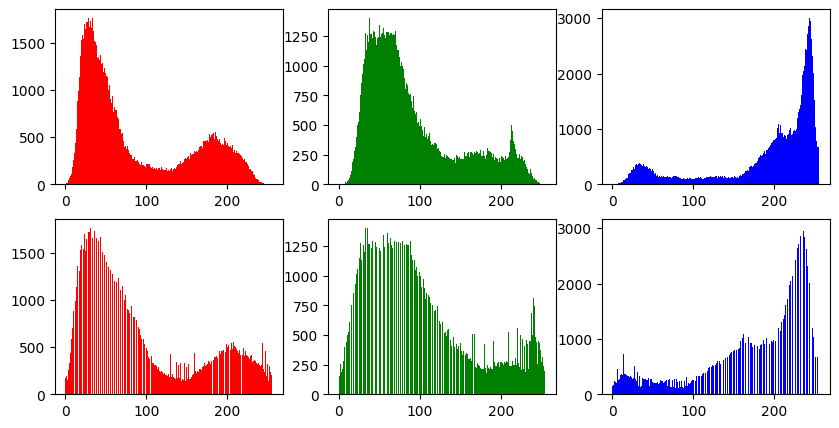

In [26]:
color_list = ["red" , "green" , "blue"]

plt.figure(figsize =(10, 5))
for i in range(3):
    plt.subplot(2,3,i+1)
    plt.hist(image[:,:,i].flatten(),256,[0,256], color = color_list[i])
    plt.subplot(2,3,i+1+3)
    plt.hist(enh_img[:,:,i].flatten(),256,[0,256], color = color_list[i])
plt.show()

- Variation in smoothness weights w.r.t contrast enhancement. These weights determine how to illuminae image and we can see how there is more prominent distinctions in the image features here.

In [27]:
def find_w(image , orientation="h"):
    L = np.max(image, axis=-1)
    if orientation=="h":
        Lp = cv2.Sobel(L, cv2.CV_64F, 1, 0, ksize=1)
    if orientation=="v":
        Lp = cv2.Sobel(L, cv2.CV_64F, 0, 1, ksize=1)

    T = convolve(np.ones_like(L), image_config["kernel"], mode='constant')
    T = T / (np.abs(convolve(Lp, image_config["kernel"], mode='constant')) + image_config["eps"])
    w = T / (np.abs(Lp) + image_config["eps"])
    return w

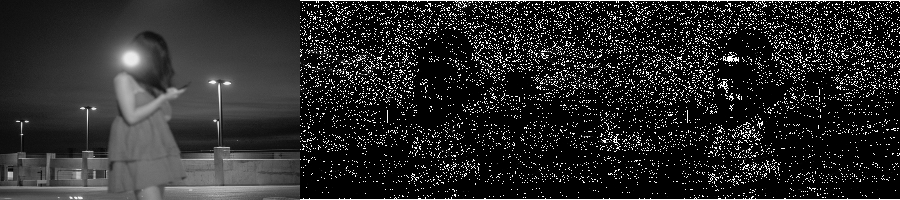

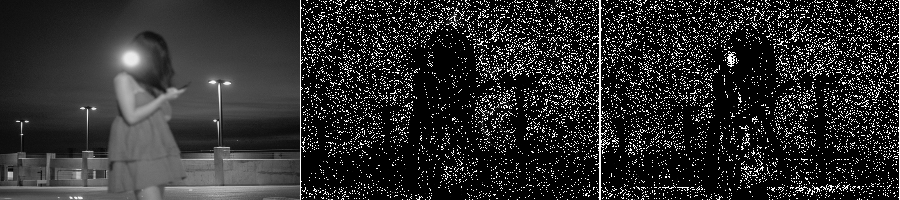

In [28]:
imgpath = "underexp1.jpeg"
image = cv2.resize(cv2.imread(imgpath) , (300,200))
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

enh_img = contrast_enhance(image)

ver = np.concatenate((gray_image,find_w(image,"v"), find_w(enh_img,"v")), axis=1)
cv2_imshow(ver)

hor = np.concatenate((gray_image,find_w(image,"h"), find_w(enh_img,"h")), axis=1)
cv2_imshow(hor)

#### Using contrast enhancement for different scenarios

- Using enhanced image during fusion phase.

From left: a) Original	 b) Using original image for fusion	 c) Using enhanced image for fusion
 


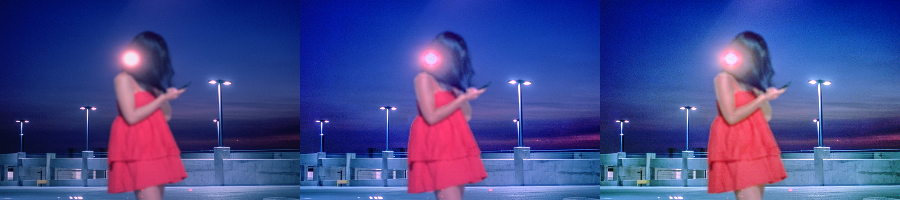

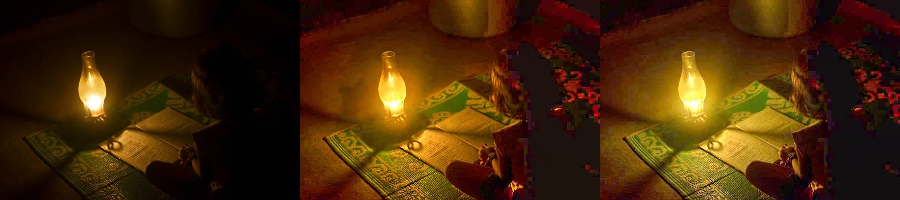

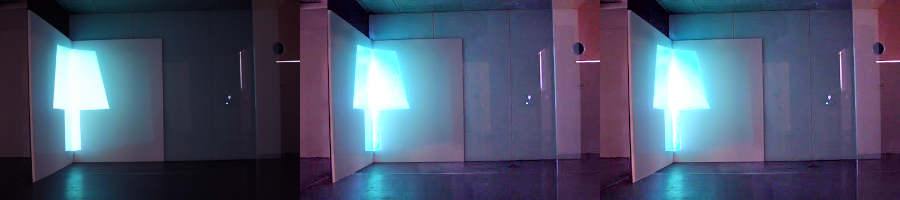

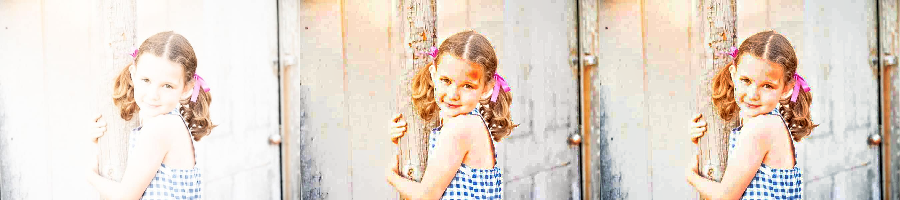

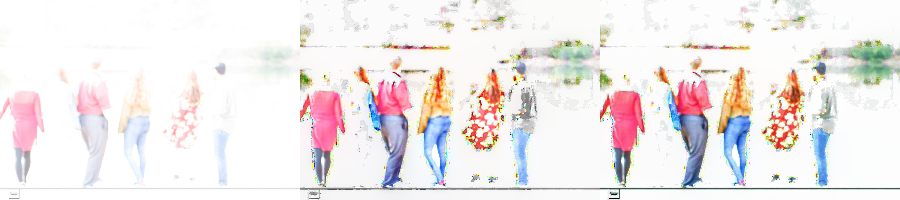

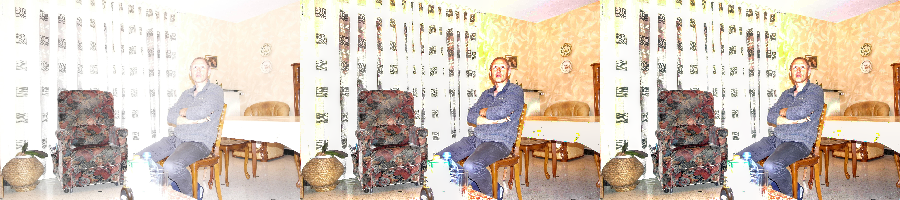

In [29]:
imgpaths = ["underexp1.jpeg","underexp2.jpeg","underexp3.jpeg" , "overexp1.jpeg" , "overexp2.jpeg","overexp3.jpeg" ]
print("From left: a) Original\t b) Using original image for fusion\t c) Using enhanced image for fusion\n ")

for imgpath in imgpaths:
    image = cv2.resize(cv2.imread(imgpath),(300,200))
    enh_img = contrast_enhance(image)

    corr1 , corr2 = illuminate_image(image,image_config)
    fused_images1 = merge(image, corr1, corr2)
    fused_images2 = merge(enh_img, corr1, corr2)


    Hori = np.concatenate((image, fused_images1), axis=1)
    Hori = np.concatenate((Hori, fused_images2), axis=1)

    cv2_imshow(Hori)

- Using enhanced image during dual illumination phase

From left: a) Original	 b) Using original image for fusion	 c) Using enhanced image dual illumination phase
 


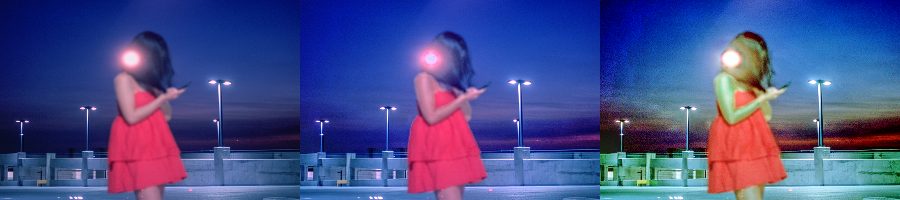

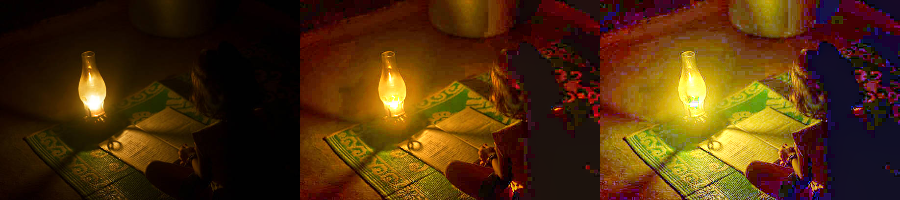

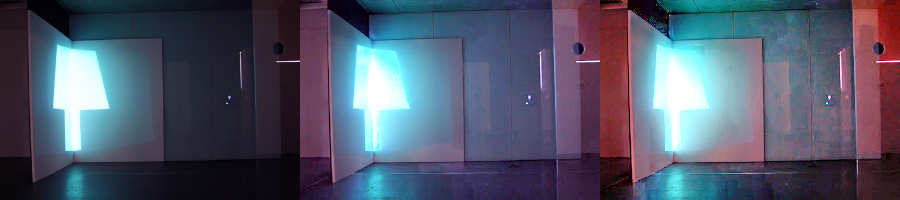

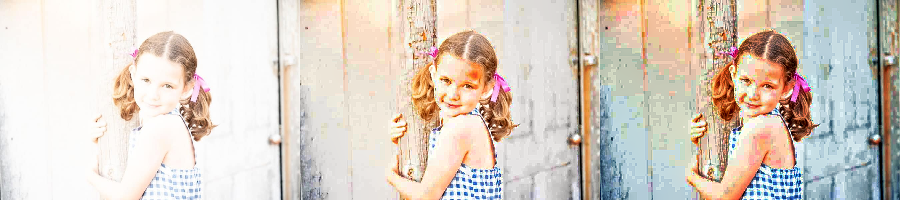

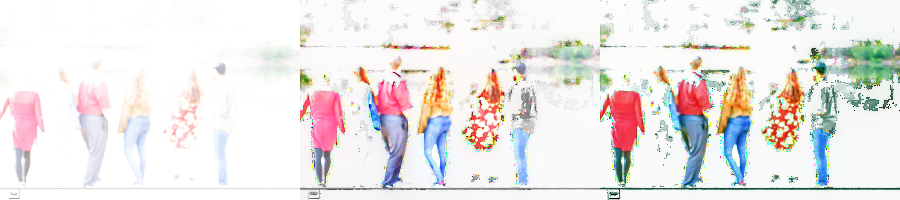

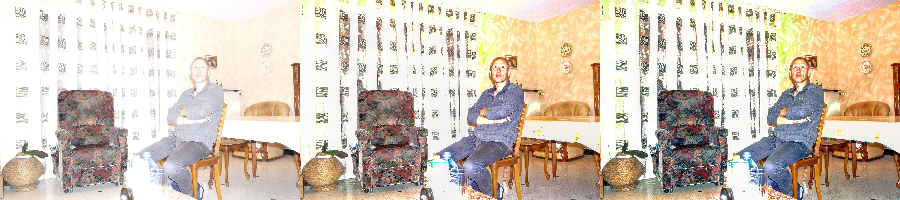

In [30]:
imgpaths = ["underexp1.jpeg","underexp2.jpeg","underexp3.jpeg" , "overexp1.jpeg" , "overexp2.jpeg" ,"overexp3.jpeg" ]
print("From left: a) Original\t b) Using original image for fusion\t c) Using enhanced image dual illumination phase\n ")

for imgpath in imgpaths:
    image = cv2.resize(cv2.imread(imgpath),(300,200))
    enh_img = contrast_enhance(image)

    corr1 , corr2 = illuminate_image(image,image_config)
    fused_images1 = merge(image, corr1, corr2)

    corr1 , corr2 = illuminate_image(enh_img,image_config)
    fused_images2 = merge(image, corr1, corr2)


    Hori = np.concatenate((image, fused_images1), axis=1)
    Hori = np.concatenate((Hori, fused_images2), axis=1)

    cv2_imshow(Hori)

- Using enhanced image during both, dual illumination and merge phase

From left: a) Original	 b) Using original image for fusion	 c) Using enhanced image for dual illumination and merge phase
 


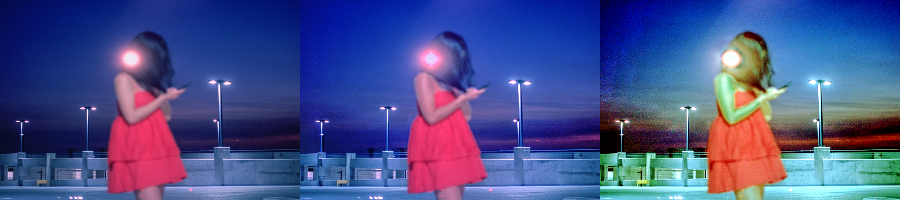

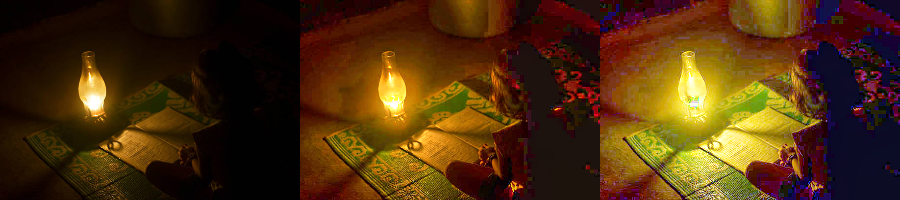

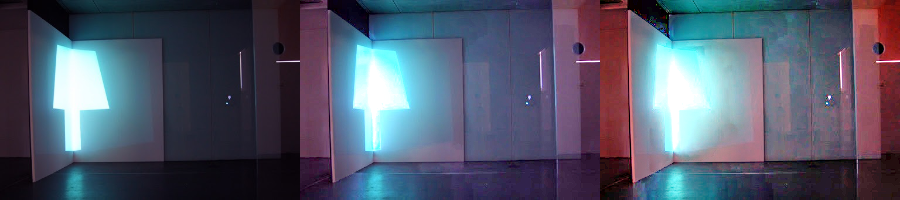

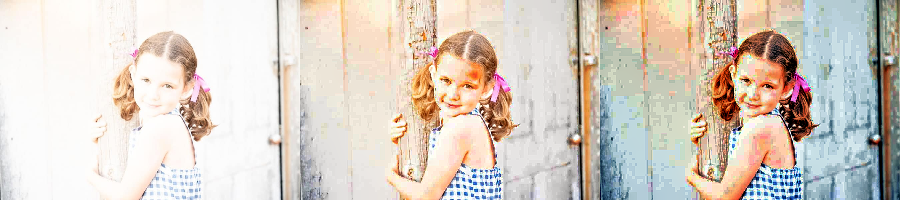

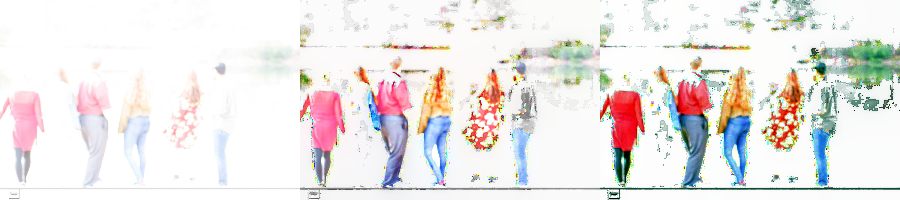

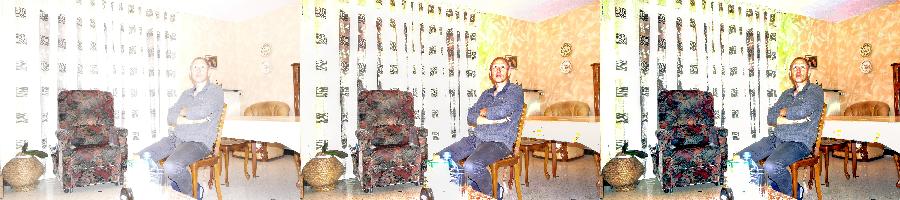

In [31]:
imgpaths = ["underexp1.jpeg","underexp2.jpeg","underexp3.jpeg" , "overexp1.jpeg" , "overexp2.jpeg" ,"overexp3.jpeg"]
print("From left: a) Original\t b) Using original image for fusion\t c) Using enhanced image for dual illumination and merge phase\n ")

for imgpath in imgpaths:
    image = cv2.resize(cv2.imread(imgpath),(300,200))
    enh_img = contrast_enhance(image)

    corr1 , corr2 = illuminate_image(image,image_config)
    fused_images1 = merge(image, corr1, corr2)

    corr1 , corr2 = illuminate_image(enh_img,image_config)
    fused_images2 = merge(enh_img, corr1, corr2)

    Hori = np.concatenate((image, fused_images1), axis=1)
    Hori = np.concatenate((Hori, fused_images2), axis=1)

    cv2_imshow(Hori)